In [88]:
import matplotlib.pyplot as plt
import numpy as np
from random import random
from skimage import io
from glob import glob


In [89]:
_IMGS = glob("./images/*.jpg")
_IMGS = [io.imread(_IMG) for _IMG in _IMGS]

# PRINT FUNCTIONS

---

In [90]:
def print_img(img, gray=False, width=10):
    img_ratio = float(img.shape[1]/img.shape[0])

    plt.figure(figsize=(width, width/img_ratio))
    plt.imshow(img, cmap=plt.get_cmap("gray")) if gray else plt.imshow(img)
    plt.colorbar()
    plt.axis('off')
    plt.show()

def print_n_imgs(imgs, titles, gray, title):
    n_imgs = len(imgs)
    fig, ax = plt.subplots(ncols=n_imgs, figsize=(n_imgs*10, 10))
    fig.suptitle(title, fontsize=30)
    fig.tight_layout()
    fig.subplots_adjust(top=0.9)

    for i in range(n_imgs):
        ax[i].imshow(imgs[i], cmap=plt.cm.gray) if gray[i] else ax[i].imshow(imgs[i])
        ax[i].set_title(titles[i])
        ax[i].axis('off')

# NOISES

---

In [91]:
gaussian_noise = lambda sigma, img : np.random.normal(0, sigma, img.shape)

In [92]:
def create_gaussian_noise(img, sigma=0.2):
    sigma *= 100
    gaussian = gaussian_noise(sigma, img)
    out = img + gaussian
    return out

In [93]:
def create_sp_noise(img, prob=0.2):
    prob /= 2
    output = np.zeros(img.shape, np.uint8)
    thres = 1 - prob 
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            rdn = random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = img[i][j]
    return output

In [94]:
def create_speckle_noise(img, sigma=0.2):
    gaussian = gaussian_noise(sigma, img)
    out = img + img * gaussian
    return out

In [95]:
# TODO: Arreglar los filtros usando esta web: https://medium.com/image-vision/noise-in-digital-image-processing-55357c9fab71

# IMAGES

---

### CHOOSE THE IMAGE

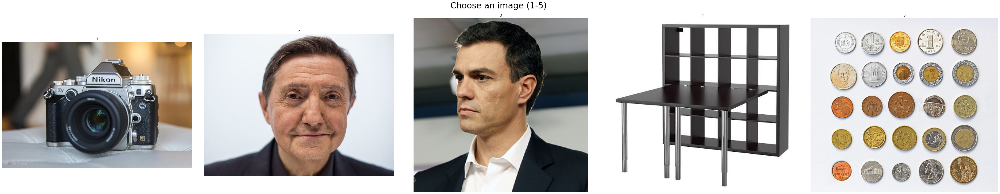

In [96]:
imgs_len = len(_IMGS)

print_n_imgs(imgs=_IMGS,
             titles=[i + 1 for i in range(imgs_len)],
             gray=[False for _ in _IMGS],
             title=f"Choose an image (1-{imgs_len})")

In [97]:
def get_input():
    try:
        n = int(input(f"Image number (1-{imgs_len}). (Default: 1): "))
    except ValueError:
        n = 1
    return n
#n = get_input()
n = 1
_IMG = _IMGS[n - 1]

### CREATE IMAGE ALTERATIONS

In [98]:
def rgb2gray(rgb_img):
    rgb_weights = [0.2989, 0.5870, 0.1140]
    gray_img = np.dot(rgb_img, rgb_weights)
    return gray_img

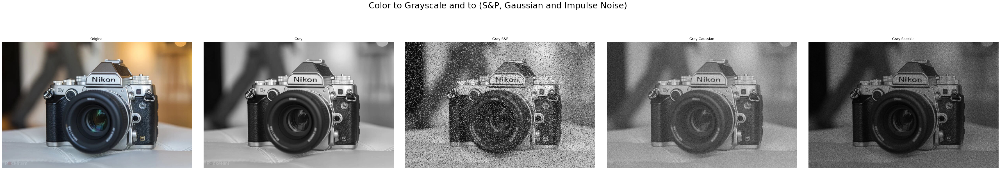

In [99]:
# Color.
img = _IMG

# Grayscale.
gray_img = rgb2gray(img)

# Salt and Pepper.
sp_gray_img = create_sp_noise(gray_img)

# Gaussian.
gaussian_gray_img = create_gaussian_noise(gray_img)

# Speckle.
speckle_gray_img = create_speckle_noise(gray_img)

print_n_imgs(title="Color to Grayscale and to (S&P, Gaussian and Impulse Noise)", 
             imgs=[img, gray_img, sp_gray_img, gaussian_gray_img, speckle_gray_img],
             titles=["Original", "Gray", "Gray S&P", "Gray Gaussian", "Gray Speckle"], 
             gray=[False, True, True, True, True])


# DIFFUSION FUNCTION

---

In [100]:
def gamma_range(gamma=0.1):
    # Gamma is range 0-1.
    gamma /= 2 # Because we apply it on both sides.
    gamma *= 255 # Color range.
    black_range = 0 + gamma
    white_range = 255 - gamma
    return black_range, white_range

def check_bounds(x, d, shape):
    n = d//2

    # Calculate bounds.
    b1 = x - n
    b2 = x + n + 1

    # Get bounded coordinates.
    x1 = min(max(b1, 0), shape)
    x2 = max(min(b2, shape), 0)

    # Set padding if bound out of image or 0 otherwise.
    p1 = abs(b1) if b1 < 0 else 0
    p2 = b2 - shape if b2 > shape else 0
    padding = (p1, p2)
    
    return x1, x2, padding

def get_neighs(img, x, y, d):
    # Get new bounds and padding.
    x1, x2, padding_x = check_bounds(x, d, img.shape[1])
    y1, y2, padding_y = check_bounds(y, d, img.shape[0])

    # Create neighs.
    neighs = img[y1:y2, x1:x2]

    # Padding given the x, y values.
    padding = [padding_y, padding_x]

    # Pad neighs.
    neighs = np.pad(neighs, padding, mode="constant")

    return neighs.flatten()


In [101]:
def diffusion(img, filter, K=200, n_neighs=10, gamma=1, n_iter=1):
    w, h = img.shape[1], img.shape[0]
    out = img.copy()
    b_range, w_range = gamma_range(gamma)

    for _ in range(n_iter):
        for x in range(w):
            for y in range(h):
                pix = out[y][x]
                if not (b_range < pix < w_range):
                    neighs = get_neighs(img, x, y, n_neighs)
                    new_pix = filter(pix, neighs, K)
                    out[y][x] = new_pix

    return out

# FILTERS

---

## MEDIAN NOISE FILTER

In [102]:
def median_filter(old_pix, neighs, K):
    new_pix = np.median(neighs)
    return new_pix

In [103]:
sp_median_filtered = diffusion(sp_gray_img, median_filter, gamma=0.1)
gaussian_median_filtered = diffusion(gaussian_gray_img, median_filter)
speckle_median_filtered = diffusion(speckle_gray_img, median_filter)

## MEAN NOISE FILTER

In [104]:
def mean_filter(old_pix, neighs, K):
    new_pix = np.mean(neighs)
    return new_pix

In [105]:
sp_mean_filtered = diffusion(sp_gray_img, mean_filter, gamma=0.1)
gaussian_mean_filtered = diffusion(gaussian_gray_img, mean_filter)
speckle_mean_filtered = diffusion(speckle_gray_img, mean_filter)

## GAUSSIAN FILTER

In [106]:
def gaussian_weight(x, y, sigma=100):
    weight = np.exp(-(x**2 + y**2)/(2*(sigma**2)))
    return weight

def gaussian_matrix(dim, sigma=100):
    if dim % 2 != 0: dim -= 1
    x = range(-dim//2, dim//2 + 1)
    weights = [gaussian_weight(0, i, sigma) for i in x]
    weights = np.outer(weights, weights)
    return weights.flatten()

def gaussian_filter(old_pix, neighs, sigma=100):
    n_len = len(neighs)
    dim = int(np.sqrt(n_len))
    weights = gaussian_matrix(dim, sigma)
    new_pix = np.dot(neighs, weights) / sum(weights)
    return new_pix

In [107]:
sp_gaussian_filtered = diffusion(sp_gray_img, gaussian_filter, gamma=0.1)
gaussian_gaussian_filtered = diffusion(gaussian_gray_img, gaussian_filter)
speckle_gaussian_filtered = diffusion(speckle_gray_img, gaussian_filter)

## ANISOTROPIC NOISE FILTER

In [108]:
# FUNCIÓN DE SIMILITUD

def similarity_rgb(p, q, K=50):
    grad = lambda pix : np.sum(np.gradient(pix))
    p_gradient = grad(p)
    q_gradient = grad(q)
    return similarity_gray(p_gradient, q_gradient, K)

def similarity_gray(p, q, K=50):
    dif = abs(p - q)
    sim = 1. if dif == 0. else 1./(1. + (dif/K)**2)
    return sim

def anisotropic_filter(old_pix, neighs, K=50):
    weights = [similarity_gray(old_pix, n, K) for n in neighs]
    new_pix = np.dot(neighs, weights) / sum(weights)
    return new_pix

In [109]:
sp_anisotropic_filtered = diffusion(sp_gray_img, anisotropic_filter, gamma=0.1)
gaussian_anisotropic_filtered = diffusion(gaussian_gray_img, anisotropic_filter)
speckle_anisotropic_filtered = diffusion(speckle_gray_img, anisotropic_filter)

# OUTPUT

---

## S&P NOISE

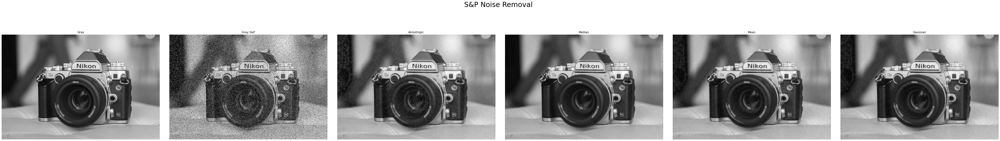

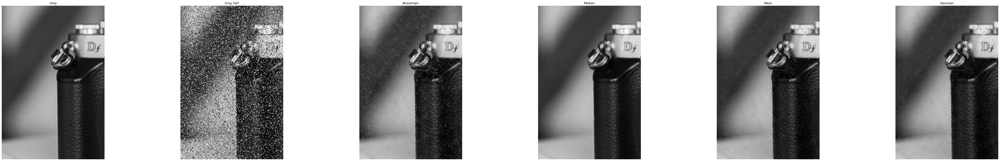

In [110]:
title = "S&P Noise Removal"
imgs = [gray_img, sp_gray_img, sp_anisotropic_filtered, sp_median_filtered, sp_mean_filtered, sp_gaussian_filtered]
w, h = img.shape[1], img.shape[0]
zoommed_imgs = [img[w//2-w//3:w//2, h//2-h//3:h//2] for img in imgs]
titles = ["Gray", "Gray S&P", "Anisotropic", "Median", "Mean", "Gaussian"]
gray = [True for _ in range(len(imgs))]

print_n_imgs(title=title, imgs=imgs, titles=titles, gray=gray)
print_n_imgs(title="", imgs=zoommed_imgs, titles=titles, gray=gray)

## GAUSSIAN NOISE

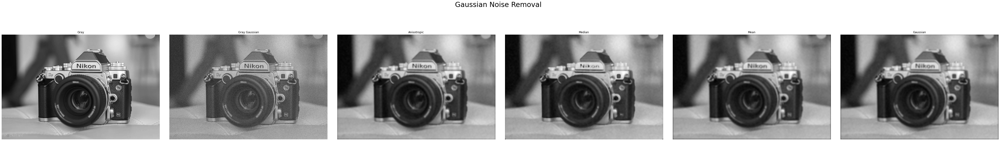

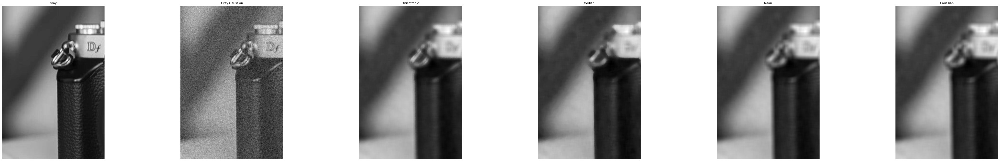

In [111]:
title = "Gaussian Noise Removal"
imgs = [gray_img, gaussian_gray_img, gaussian_anisotropic_filtered, gaussian_median_filtered, gaussian_mean_filtered, gaussian_gaussian_filtered]
zoommed_imgs = [img[w//2-w//3:w//2, h//2-h//3:h//2] for img in imgs]
titles = ["Gray", "Gray Gaussian", "Anisotropic", "Median", "Mean", "Gaussian"]
gray = [True for _ in range(len(imgs))]

print_n_imgs(title=title, imgs=imgs, titles=titles, gray=gray)
print_n_imgs(title="", imgs=zoommed_imgs, titles=titles, gray=gray)

## SPECKLE NOISE

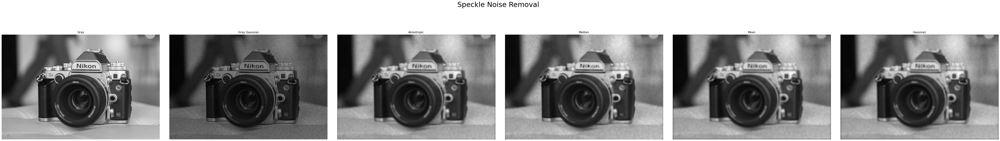

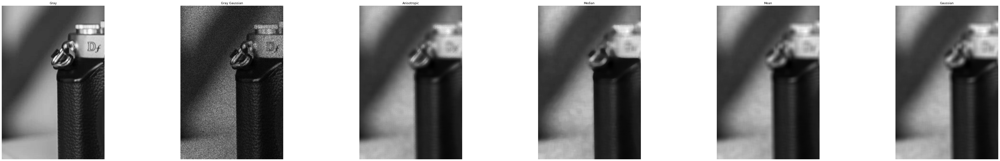

In [113]:
title = "Speckle Noise Removal"
imgs = [gray_img, speckle_gray_img, speckle_anisotropic_filtered, speckle_median_filtered, speckle_mean_filtered, speckle_gaussian_filtered]
zoommed_imgs = [img[w//2-w//3:w//2, h//2-h//3:h//2] for img in imgs]
titles = ["Gray", "Gray Gaussian", "Anisotropic", "Median", "Mean", "Gaussian"]
gray = [True for _ in range(len(imgs))]

print_n_imgs(title=title, imgs=imgs, titles=titles, gray=gray)
print_n_imgs(title="", imgs=zoommed_imgs, titles=titles, gray=gray)